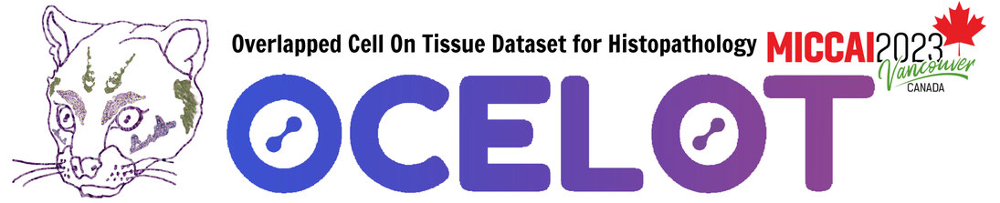

# Submission
- Docker 제출
    - https://github.com/lunit-io/ocelot23algo/tree/main

- Evaluation
    - F1 = 2 * Precision * Recall / (Precision + Recall)
    - Precision = TP / (TP + FP)
    - Recall = TP / (TP + FN)

In [ ]:
!nvidia-smi
#
# # node f / pip install 잘 안될때....
# import os
# os.environ["HTTP_PROXY"] = "http://192.168.45.100:3128"
# os.environ["HTTPS_PROXY"] = "http://192.168.45.100:3128"

In [ ]:
import os 

!nvidia-smi
os.environ["CUDA_DEVICE_ORDER"]     =  'PCI_BUS_ID'
os.environ["CUDA_VISIBLE_DEVICES"]  =  '3'


In [ ]:
# !pip install torch==1.13.1+cu117 torchvision==0.14.1+cu117 torchaudio==0.13.1 --extra-index-url https://download.pytorch.org/whl/cu117
# !pip freeze > /workspace/sunggu/0.Challenge/requirements.txt
!pip install -r requirements.txt

# EDA from the tif files

In [2]:
import re
import glob

def list_sort_nicely(l):
    def convert(text): return int(text) if text.isdigit() else text
    def alphanum_key(key): return [convert(c) for c in re.split('([0-9]+)', key)]
    return sorted(l, key=alphanum_key)

In [3]:
# json 읽기
import json
with open('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/metadata.json') as json_file:
    json_data = json.load(json_file)
    print(json_data)

{'general_info': {'description': 'The OCELOT 2023 dataset is a histopathology dataset designed to facilitate the development of methods that utilize cell and tissue relationships. The dataset comprises both small and large field-of-view (FoV) patches extracted from digitally scanned whole slide images (WSIs), with overlapping regions. The small and large FoV patches are accompanied by annotations of cells and tissues, respectively. The WSIs are sourced from the publicly available TCGA database and were stained using the H&E method before being scanned with an Aperio scanner.', 'url': 'https://lunit-io.github.io/research/ocelot_dataset/', 'version': '0.1.2', 'version_log': 'Modify coordinates of cell labels to range from 0 to 1023 (-1 from previous coordinates)', 'year': '2023', 'organization': 'Lunit Inc.', 'license': 'Creative Commons Attribution-NonCommercial 4.0 International License (CC BY-NC 4.0). You are permitted to utilize any of the material in your own research, provided that

In [ ]:
json_data.keys()

In [ ]:
json_data['general_info']

In [ ]:
json_data['label_info']

In [ ]:
json_data['field_description']

In [ ]:
json_data['sample_pairs']['001'].keys()

In [ ]:
json_data['sample_pairs']['001']

In [ ]:
68556-67768, 30732-29944

In [ ]:
69344-66192, 31520-28368

In [ ]:
3152/788

In [ ]:
json_data['sample_pairs']['001'].keys()

In [ ]:
json_data['sample_pairs']['001']

In [ ]:
def convert_coordinate(meta):
    t_xstart = meta['tissue']['x_start']
    t_xend   = meta['tissue']['x_end']
    t_ystart = meta['tissue']['y_start']
    t_yend   = meta['tissue']['y_end']    

    x_start = (meta['cell']['x_start'] - t_xstart) * 1024.0 / (t_xend - t_xstart)
    x_end   = (meta['cell']['x_end'] - t_xstart) * 1024.0 / (t_xend - t_xstart)
    y_start = (meta['cell']['y_start'] - t_ystart) * 1024.0 / (t_yend - t_ystart)
    y_end   = (meta['cell']['y_end'] - t_ystart) * 1024.0 / (t_yend - t_ystart)

    return y_start, y_end, x_start, x_end


In [ ]:
import matplotlib.pyplot as plt
import cv2

ocelot2023_cell   = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/*.jpg'))
ocelot2023_tissue = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/tissue/*.jpg'))

key_list = list(json_data['sample_pairs'].keys())

for i in range(400):
    x_start = int(x_convert(target='x_start', meta=json_data['sample_pairs'][key_list[i]]))
    x_end   = int(x_convert(target='x_end', meta=json_data['sample_pairs'][key_list[i]]))

    y_start = int(y_convert(target='y_start', meta=json_data['sample_pairs'][key_list[i]]))
    y_end   = int(y_convert(target='y_end', meta=json_data['sample_pairs'][key_list[i]]))

    if x_start != y_start:
        print("x_start = ", x_start, x_end)
        print("y_start = ", y_start, y_end)

    plt.figure(figsize=(10, 5))
    # /workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/001.jpg 읽기
    img = cv2.imread(ocelot2023_cell[i])
    plt.subplot(1,2,1)
    plt.imshow(img)

    img = cv2.imread(ocelot2023_tissue[i])
    plt.subplot(1,2,2)
    plt.imshow(img[y_start:y_end, x_start:x_end, :])
    
    plt.show()


# Parsing

In [ ]:
cell_list   = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/*.jpg'))
tissue_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/tissue/*.jpg'))

In [ ]:
import cv2
img = cv2.imread(cell_list[0])

In [ ]:
img.shape

In [ ]:
import cv2
from tqdm import tqdm

shape_list = []
max_list = []
min_list = []
for i in tqdm(cell_list):
    img = cv2.imread(i)
    shape_list.append(img.shape)  # 이미지 형식
    max_list.append(img.max())    # 이미지 크기 (너비, 높이)
    min_list.append(img.min())    # 이미지 크기 (너비, 높이)



In [ ]:
# 데이터 프레임
import pandas as pd
df = pd.DataFrame({'shape':shape_list, 'max':max_list, 'min':min_list})

In [ ]:
df['min'].describe()

In [ ]:
df['max'].describe()

In [ ]:
df['shape'].describe()

In [ ]:
import cv2
from tqdm import tqdm

shape_list = []
max_list = []
min_list = []
for i in tqdm(tissue_list):
    img = cv2.imread(i)
    shape_list.append(img.shape)  # 이미지 형식
    max_list.append(img.max())    # 이미지 크기 (너비, 높이)
    min_list.append(img.min())    # 이미지 크기 (너비, 높이)



In [ ]:
df['min'].describe()

In [ ]:
df['max'].describe()

In [ ]:
df['shape'].describe()

# Segmentation gt map 만들기

## 가우시안 블롭

In [ ]:
def min_max_normalization(image, **kwargs):
    if len(np.unique(image)) != 1:  # Sometimes it cause the nan inputs...
        image = image.astype('float32')
        image -= image.min()
        image /= image.max() 
    return image

In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.morphology import dilation, disk
import matplotlib.pyplot as plt

csv_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_csv/*.csv'))
png_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/*.jpg'))
selem = min_max_normalization(cv2.GaussianBlur(disk(7).astype('float'), (0, 0), sigmaX=3.0))



In [ ]:
plt.imshow(min_max_normalization(cv2.GaussianBlur(disk(7).astype('float'), (0, 0), sigmaX=3.0)))

In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.morphology import dilation, disk
import matplotlib.pyplot as plt
from scipy import ndimage

csv_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/train/cell_csv/*.csv'))
png_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/*.jpg'))
selem = min_max_normalization(cv2.GaussianBlur(disk(7).astype('float'), (0, 0), sigmaX=3.0))

for c, p in zip(csv_list, png_list):
    # read csv
    arr = cv2.imread(p, cv2.IMREAD_COLOR)
    arr = cv2.cvtColor(arr, cv2.COLOR_BGR2RGB)

    try:
        df = pd.read_csv(c, header=None)
        df.columns = ['x', 'y', 'class']

        #1
        class_1_gt = np.zeros((1024, 1024))
        for i in df[df['class']==1].values:
            class_1_gt[i[1], i[0]] = 1
        pad_size = selem.shape[0] // 2
        class_1_gt = np.pad(class_1_gt, pad_size, mode='constant', constant_values=0)
        class_1_gt = ndimage.convolve(class_1_gt, selem)
        class_1_gt = min_max_normalization(class_1_gt)

        #2
        class_2_gt = np.zeros((1024, 1024))
        for i in df[df['class']==2].values:
            class_2_gt[i[1], i[0]] = 1
        pad_size = selem.shape[0] // 2
        class_2_gt = np.pad(class_2_gt, pad_size, mode='constant', constant_values=0)    
        class_2_gt = ndimage.convolve(class_2_gt, selem)
        class_2_gt = min_max_normalization(class_2_gt)

    except:
        class_1_gt = np.zeros((1024, 1024))
        class_2_gt = np.zeros((1024, 1024))

    print("class_1_gt == ", class_1_gt.max(), class_1_gt.min())
    print("class_2_gt == ", class_2_gt.max(), class_2_gt.min())

    obj = class_1_gt + class_2_gt
    bg  = 1 - obj

    gt = np.stack([bg, class_1_gt, class_2_gt], axis=-1) # H, W, C

    # gt save in npy
    np.save(c.replace('/cell_csv/', '/cell_gaussian/').replace('.csv', '.npy'), gt)

    # plt.figure(figsize=(20, 5))
    # plt.subplot(1, 3, 1)
    # plt.imshow(class_1_gt)
    # plt.subplot(1, 3, 2)
    # plt.imshow(class_2_gt)
    # plt.subplot(1, 3, 3)
    # plt.imshow(obj)
    # plt.show()

    


In [ ]:
gt = pd.DataFrame([])

gt_cls = np.array([g for g in gt if g[2] == 1], np.float32)

if len(gt_cls) == 0:
    gt_cls = np.zeros(shape=(0, 4))

In [ ]:
gt

In [ ]:
gt_cls

## Disk - segmentation map

In [ ]:
import cv2
import numpy as np
import pandas as pd
from skimage.morphology import dilation, disk
import matplotlib.pyplot as plt

csv_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/train/cell_csv/*.csv'))
png_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/*.jpg'))
selem = disk(7)

for c, p in zip(csv_list, png_list):
    # read csv
    arr = cv2.imread(p, cv2.IMREAD_COLOR)
    arr = cv2.cvtColor(arr, cv2.COLOR_BGR2RGB)

    try:
        df = pd.read_csv(c, header=None)
        df.columns = ['x', 'y', 'class']
    
        #1
        class_1_gt = np.zeros((1024, 1024))
        for i in df[df['class']==1].values:
            class_1_gt[i[1], i[0]] = int(1)
        class_1_gt = dilation(class_1_gt, selem)
        
        #2
        class_2_gt = np.zeros((1024, 1024))
        for i in df[df['class']==2].values:
            class_2_gt[i[1], i[0]] = int(2)
        class_2_gt = dilation(class_2_gt, selem)

    except:
        class_1_gt = np.zeros((1024, 1024))
        class_2_gt = np.zeros((1024, 1024))

    print(class_1_gt.max(), class_1_gt.min())
    print(class_2_gt.max(), class_2_gt.min())

    gt = class_1_gt + class_2_gt

    gt[gt==0] = int(255)

    # plt.figure(figsize=(15, 5))
    # plt.subplot(131)
    # plt.imshow(arr)
    # plt.imshow(gt, alpha=0.5)
    # plt.axis('off')
    # plt.tight_layout()

    # plt.subplot(132)
    # plt.imshow(class_1_gt*1)
    # plt.axis('off')
    # plt.tight_layout()

    # plt.subplot(133)
    # plt.imshow(class_2_gt*2)    
    # plt.axis('off')
    # plt.tight_layout()    
    # plt.show()

    print(np.unique(gt, return_counts=True))

    # save gt into png
    cv2.imwrite(c.replace('/cell_csv/', '/cell_seg/').replace('.csv', '.png'), gt)



In [25]:
a = cv2.imread('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/005-labels.png', cv2.IMREAD_GRAYSCALE)

In [30]:
np.unique(a)

array([ 29, 149, 255], dtype=uint8)

In [31]:
# extract certain classes from mask
a = [(a == v) for v in [255, 29, 149]]
a = np.stack(a, axis=-1)   

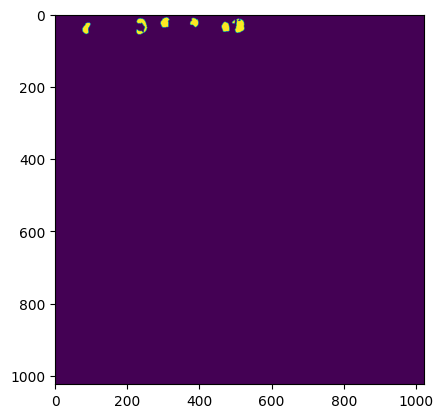

In [34]:
plt.imshow(a[..., 2])

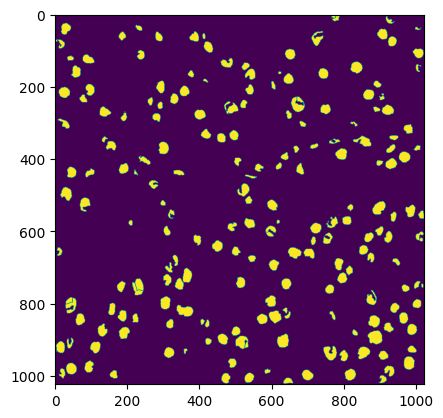

In [35]:
plt.imshow(a[..., 1])

In [28]:
np.unique(a)

array([ 29, 149, 255], dtype=uint8)

In [15]:
a.shape

(1024, 1024)

# Tissue crop map 만들기

In [2]:
import re
import glob

def list_sort_nicely(l):
    def convert(text): return int(text) if text.isdigit() else text
    def alphanum_key(key): return [convert(c) for c in re.split('([0-9]+)', key)]
    return sorted(l, key=alphanum_key)

In [79]:
# json 읽기
import json
with open('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/metadata.json') as json_file:
    json_data = json.load(json_file)
    print(json_data)

{'general_info': {'description': 'The OCELOT 2023 dataset is a histopathology dataset designed to facilitate the development of methods that utilize cell and tissue relationships. The dataset comprises both small and large field-of-view (FoV) patches extracted from digitally scanned whole slide images (WSIs), with overlapping regions. The small and large FoV patches are accompanied by annotations of cells and tissues, respectively. The WSIs are sourced from the publicly available TCGA database and were stained using the H&E method before being scanned with an Aperio scanner.', 'url': 'https://lunit-io.github.io/research/ocelot_dataset/', 'version': '0.1.2', 'version_log': 'Modify coordinates of cell labels to range from 0 to 1023 (-1 from previous coordinates)', 'year': '2023', 'organization': 'Lunit Inc.', 'license': 'Creative Commons Attribution-NonCommercial 4.0 International License (CC BY-NC 4.0). You are permitted to utilize any of the material in your own research, provided that

In [80]:
json_data

{'general_info': {'description': 'The OCELOT 2023 dataset is a histopathology dataset designed to facilitate the development of methods that utilize cell and tissue relationships. The dataset comprises both small and large field-of-view (FoV) patches extracted from digitally scanned whole slide images (WSIs), with overlapping regions. The small and large FoV patches are accompanied by annotations of cells and tissues, respectively. The WSIs are sourced from the publicly available TCGA database and were stained using the H&E method before being scanned with an Aperio scanner.',
  'url': 'https://lunit-io.github.io/research/ocelot_dataset/',
  'version': '0.1.2',
  'version_log': 'Modify coordinates of cell labels to range from 0 to 1023 (-1 from previous coordinates)',
  'year': '2023',
  'organization': 'Lunit Inc.',
  'license': 'Creative Commons Attribution-NonCommercial 4.0 International License (CC BY-NC 4.0). You are permitted to utilize any of the material in your own research, p

In [7]:
def convert_coordinate(meta):
    t_xstart = meta['tissue']['x_start']
    t_xend   = meta['tissue']['x_end']
    t_ystart = meta['tissue']['y_start']
    t_yend   = meta['tissue']['y_end']    

    c_xstart = meta['cell']['x_start']
    c_xend   = meta['cell']['x_end']
    c_ystart = meta['cell']['y_start']
    c_yend   = meta['cell']['y_end']        

    x_factor = 1024.0 / (t_xend - t_xstart)
    y_factor = 1024.0 / (t_yend - t_ystart)

    x_start = (c_xstart - t_xstart) * x_factor
    x_end   = (c_xend   - t_xstart) * x_factor
    y_start = (c_ystart - t_ystart) * y_factor
    y_end   = (c_yend   - t_ystart) * y_factor

    # print("c == ", round(y_start), round(y_end), round(x_start), round(x_end))
    # return int(y_start), int(y_end), int(x_start), int(x_end)
    return round(y_start), round(y_end), round(x_start), round(x_end)


In [10]:
convert_coordinate(json_data['sample_pairs'][key_list[i]])

c ==  512 768 0 256


(511, 767, 0, 255)

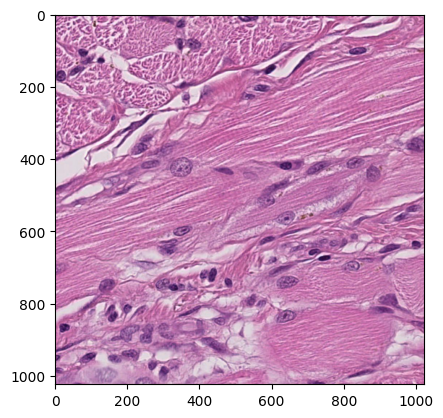

In [42]:
cell = cv2.imread(ocelot2023_cell[i], cv2.IMREAD_COLOR)
cell = cv2.cvtColor(cell, cv2.COLOR_BGR2RGB)    
plt.imshow(cell)

In [82]:
json_data['sample_pairs']['001']

{'slide_name': 'TCGA-4A-A93X-01Z-00-DX2.45011BF1-FED8-4D22-B5E1-C63DC384FD2A',
 'cell': {'x_start': 67768,
  'y_start': 29944,
  'x_end': 68556,
  'y_end': 30732,
  'resized_mpp_x': 0.1944605476455763,
  'resized_mpp_y': 0.1944605476455763},
 'tissue': {'x_start': 66192,
  'y_start': 28368,
  'x_end': 69344,
  'y_end': 31520,
  'resized_mpp_x': 0.7778421905823052,
  'resized_mpp_y': 0.7778421905823052},
 'patch_x_offset': 0.625,
 'patch_y_offset': 0.625,
 'mpp_x': 0.25270000100135803,
 'mpp_y': 0.25270000100135803,
 'organ': 'kidney',
 'subset': 'train'}

In [5]:
key_list = list(json_data['sample_pairs'].keys())

/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/004.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/004.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/004.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/004.png


/tmp/ipykernel_321574/1321859041.py:66: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1,4,3)


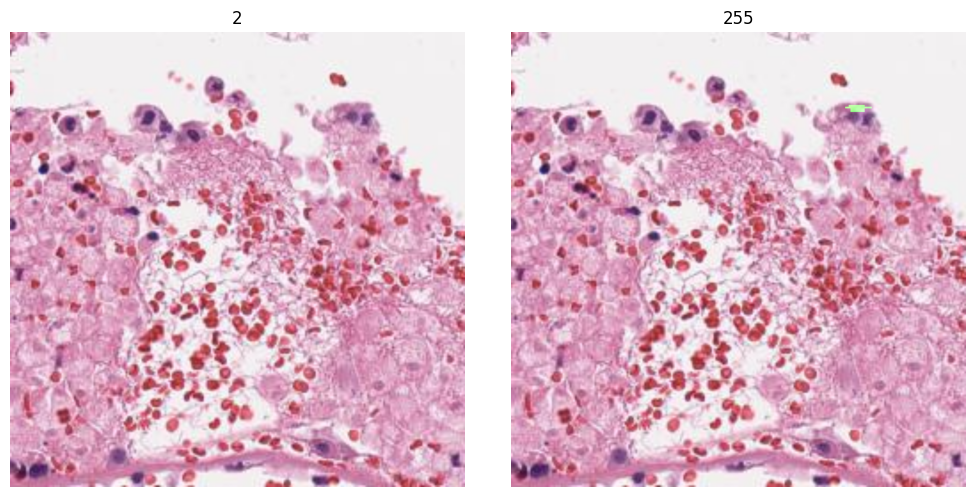


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/013.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/013.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/013.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/013.png


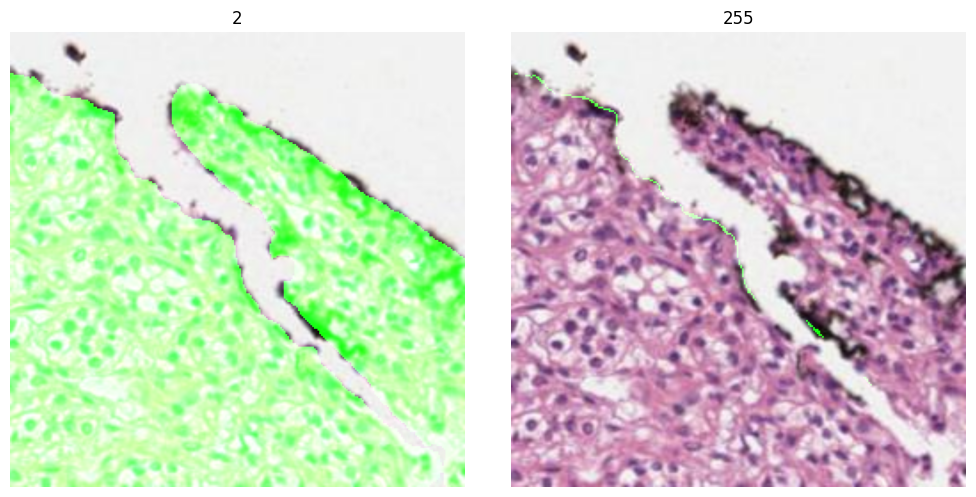


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/014.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/014.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/014.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/014.png


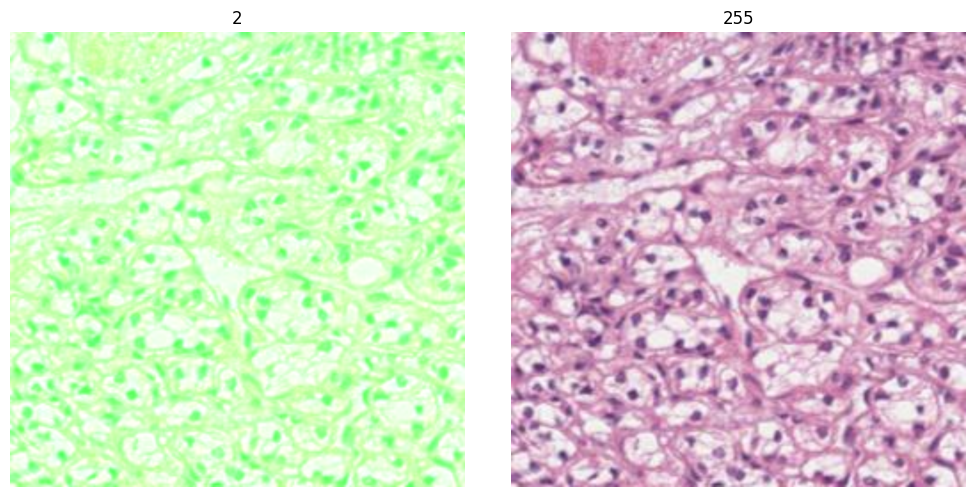


x_start =  512 768
y_start =  0 256
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/016.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/016.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/016.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/016.png


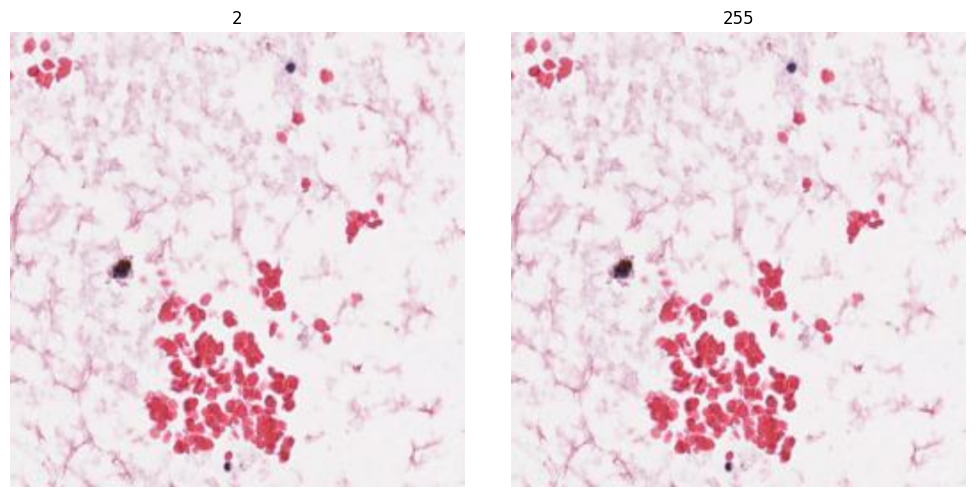


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/017.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/017.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/017.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/017.png


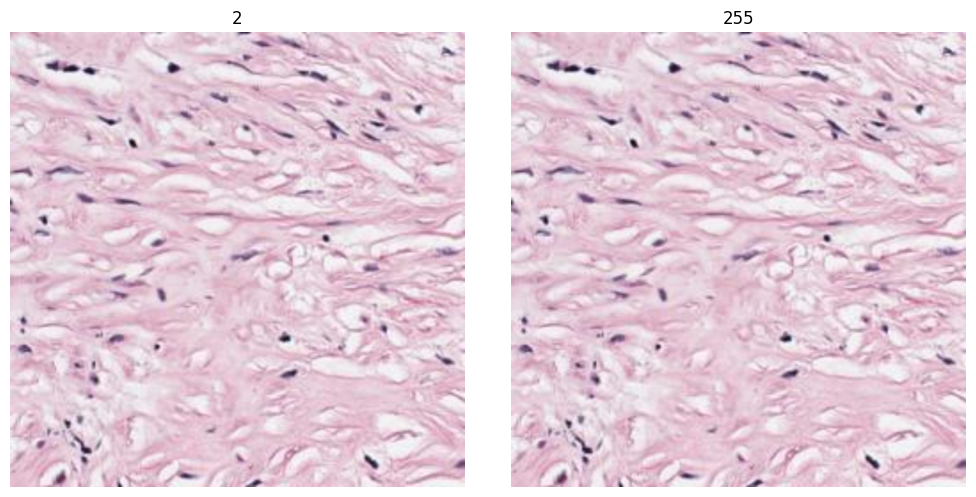


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/023.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/023.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/023.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/023.png


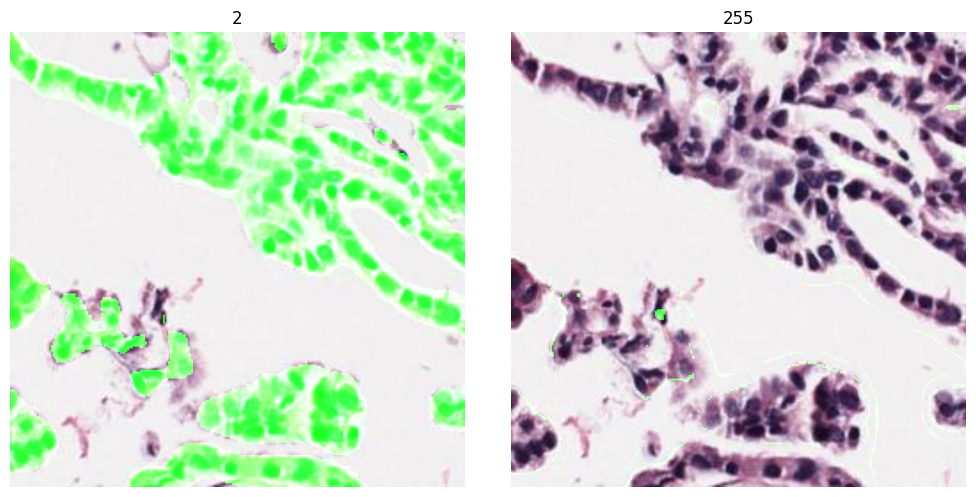


x_start =  512 768
y_start =  0 256
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/024.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/024.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/024.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/024.png


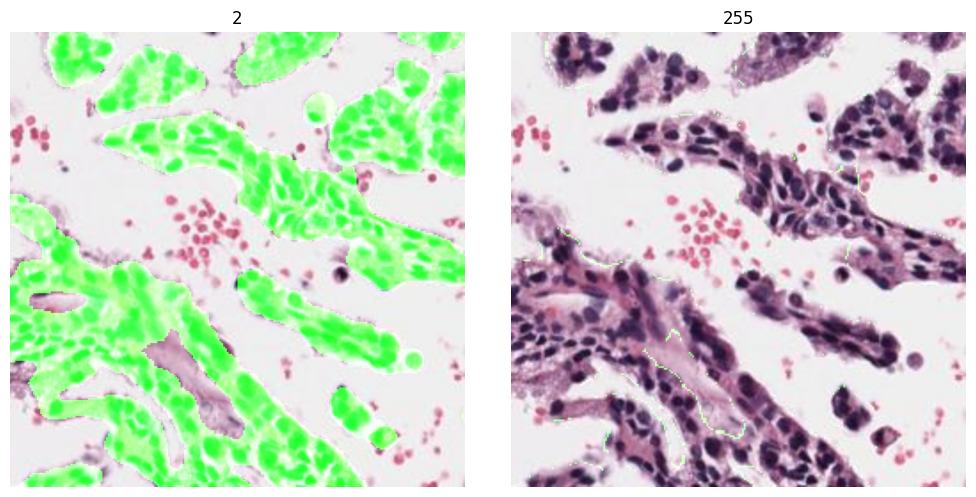


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/036.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/036.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/036.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/036.png


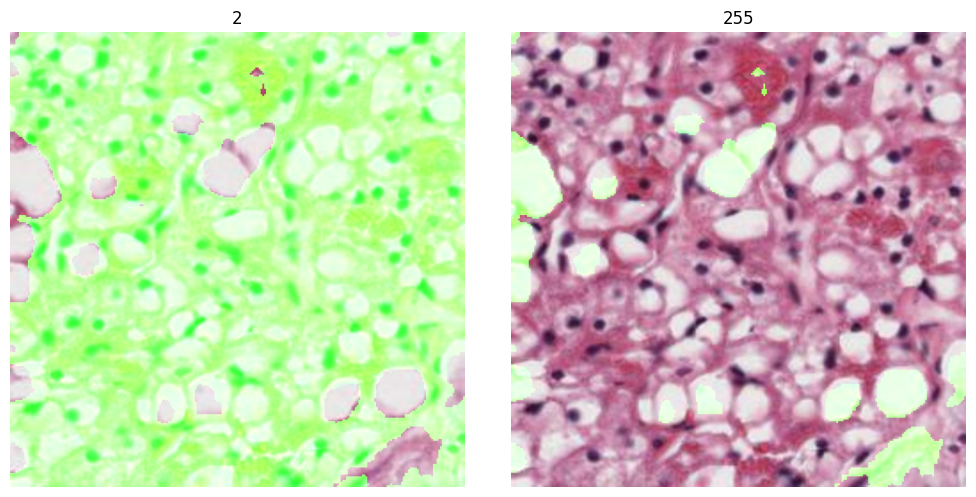


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/041.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/041.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/041.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/041.png


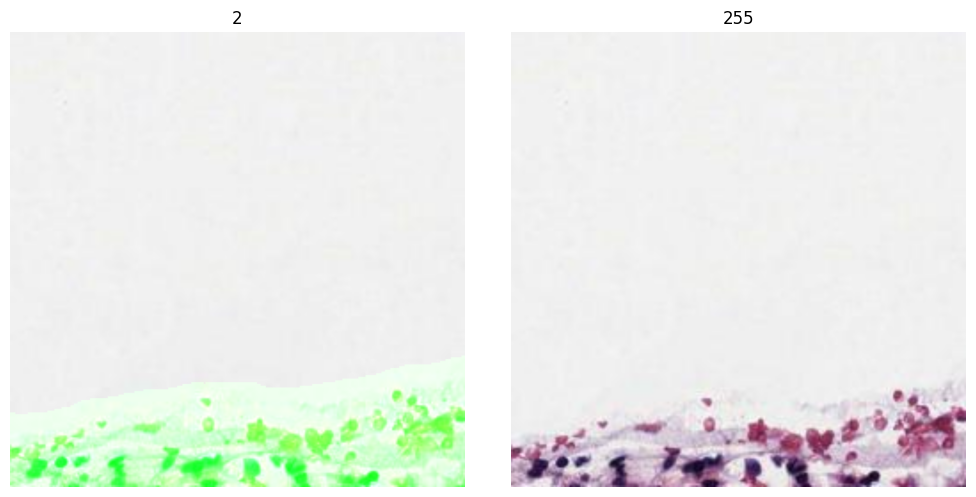


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/045.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/045.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/045.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/045.png


KeyboardInterrupt: 

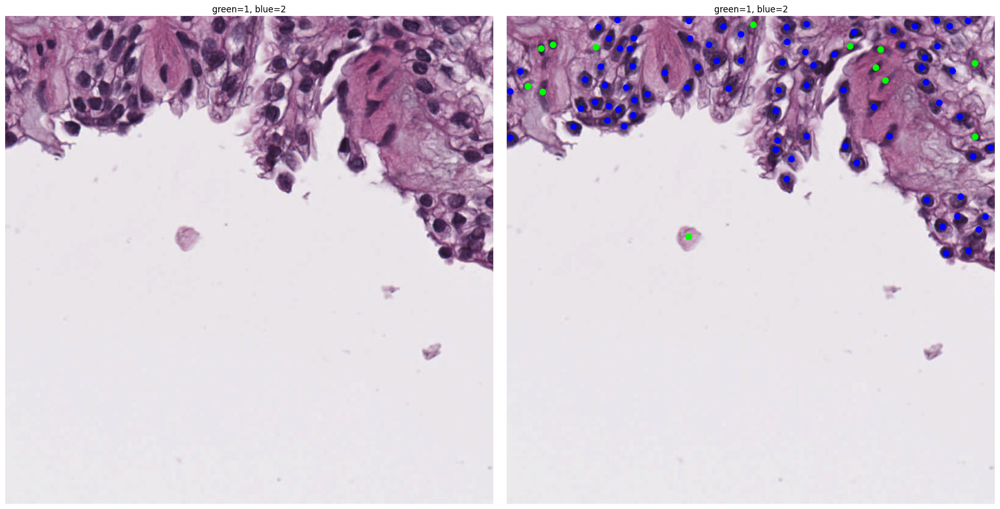

In [76]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

ocelot2023_cell      = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/*.jpg'))
ocelot2023_cell_gt   = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/*.png'))
ocelot2023_tissue    = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/*.jpg'))
ocelot2023_tissue_gt = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/*.png'))

key_list = list(json_data['sample_pairs'].keys())

for i in range(len(ocelot2023_cell)):
    y_start, y_end, x_start, x_end = convert_coordinate(json_data['sample_pairs'][key_list[i]])

    if x_start != y_start:
        print("x_start = ", x_start, x_end)
        print("y_start = ", y_start, y_end)
    

    print(ocelot2023_cell[i])
    print(ocelot2023_cell_gt[i])
    print(ocelot2023_tissue[i])
    print(ocelot2023_tissue_gt[i])

    cell = cv2.imread(ocelot2023_cell[i], cv2.IMREAD_COLOR)
    cell = cv2.cvtColor(cell, cv2.COLOR_BGR2RGB)    

    cell_gt = cv2.imread(ocelot2023_cell_gt[i], cv2.IMREAD_GRAYSCALE)

    tissue = cv2.imread(ocelot2023_tissue[i], cv2.IMREAD_COLOR)
    tissue = cv2.cvtColor(tissue, cv2.COLOR_BGR2RGB)    

    tissue_gt = cv2.imread(ocelot2023_tissue_gt[i], cv2.IMREAD_GRAYSCALE)


    plt.figure(figsize=(20, 10))

    plt.subplot(1,2,1)   
    # cell[..., 1][cell_gt==1] = 255
    # cell[..., 2][cell_gt==2] = 255
    plt.tight_layout()
    plt.axis('off')
    plt.title('green=1, blue=2')
    plt.imshow(cell)
    

    plt.subplot(1,2,2)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue, (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)
    
    cropped_tissue[..., 1][cropped_tissue_gt==1] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('1')
    plt.imshow(cropped_tissue)
    cell[cell_gt==1] = (0, 255, 0) # R G B
    cell[cell_gt==2] = (0, 0, 255) # R G B 저장할때 cv2는 BGR을 받기 때문에 바꿔 줘야함.
    plt.tight_layout()
    plt.axis('off')
    plt.title('green=1, blue=2')
    plt.imshow(cell)


    plt.subplot(1,4,3)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue, (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)

    cropped_tissue[..., 1][cropped_tissue_gt==2] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('2')
    plt.imshow(cropped_tissue)


    plt.subplot(1,4,4)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue, (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)

    cropped_tissue[..., 1][cropped_tissue_gt==255] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('255')
    plt.imshow(cropped_tissue)

    plt.show()
    
    print("=================================================")
    print("")

    # cell RGB to BGR
    # cell = cv2.cvtColor(cell, cv2.COLOR_RGB2BGR)
    # cv2.imwrite(ocelot2023_cell[i].replace('/cell', '/cell_overlap').replace('.jpg', '.png'), cell)

    


In [52]:
json_data['sample_pairs'][key_list[389]]

{'slide_name': 'TCGA-QK-A6IF-01Z-00-DX1.7B689FEA-436B-4406-8107-0160732661B0',
 'cell': {'x_start': 52725,
  'y_start': 33392,
  'x_end': 53603,
  'y_end': 34270,
  'resized_mpp_x': 0.19429180221050046,
  'resized_mpp_y': 0.19429180221050046},
 'tissue': {'x_start': 52725,
  'y_start': 31635,
  'x_end': 56240,
  'y_end': 35150,
  'resized_mpp_x': 0.7778310760477325,
  'resized_mpp_y': 0.7778310760477325},
 'patch_x_offset': 0.125,
 'patch_y_offset': 0.625,
 'mpp_x': 0.22660000622272491,
 'mpp_y': 0.22660000622272491,
 'organ': 'head-and-neck',
 'subset': 'train'}

In [84]:
key_list[390]

'391'

In [53]:
json_data['sample_pairs'][key_list[390]]

{'slide_name': 'TCGA-QK-A6IF-01Z-00-DX1.7B689FEA-436B-4406-8107-0160732661B0',
 'cell': {'x_start': 17575,
  'y_start': 15817,
  'x_end': 18453,
  'y_end': 16695,
  'resized_mpp_x': 0.19429180221050046,
  'resized_mpp_y': 0.19429180221050046},
 'tissue': {'x_start': 17575,
  'y_start': 14060,
  'x_end': 21090,
  'y_end': 17575,
  'resized_mpp_x': 0.7778310760477325,
  'resized_mpp_y': 0.7778310760477325},
 'patch_x_offset': 0.125,
 'patch_y_offset': 0.625,
 'mpp_x': 0.22660000622272491,
 'mpp_y': 0.22660000622272491,
 'organ': 'head-and-neck',
 'subset': 'train'}

In [86]:
[i.split('/')[-1].replace('.jpg', '') for i in ocelot2023_cell]

['004',
 '013',
 '014',
 '016',
 '017',
 '023',
 '024',
 '036',
 '041',
 '045',
 '048',
 '050',
 '052',
 '053',
 '058',
 '064',
 '072',
 '080',
 '082',
 '084',
 '099',
 '102',
 '108',
 '111',
 '112',
 '113',
 '115',
 '117',
 '120',
 '126',
 '136',
 '137',
 '141',
 '143',
 '149',
 '151',
 '173',
 '175',
 '177',
 '182',
 '184',
 '186',
 '187',
 '190',
 '194',
 '195',
 '215',
 '230',
 '233',
 '236',
 '259',
 '275',
 '280',
 '283',
 '288',
 '296',
 '302',
 '303',
 '309',
 '310',
 '317',
 '322',
 '326',
 '328',
 '333',
 '339',
 '344',
 '347',
 '350',
 '358',
 '360',
 '361',
 '367',
 '374',
 '378',
 '380',
 '389',
 '391',
 '396']

In [14]:
ocelot2023_tissue

[]

/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/378.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/378.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/378.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/378.png


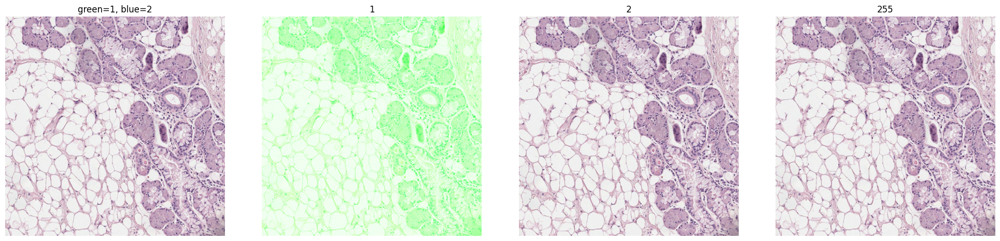

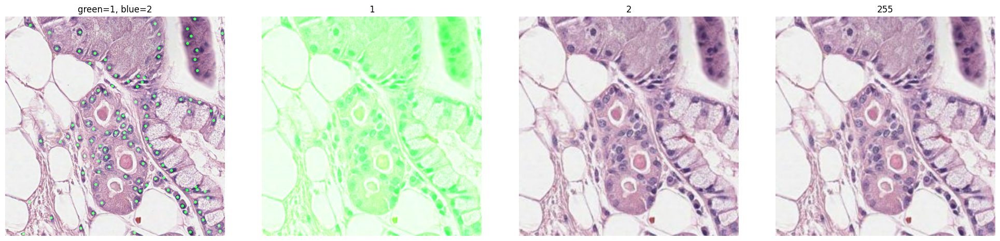


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/380.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/380.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/380.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/380.png


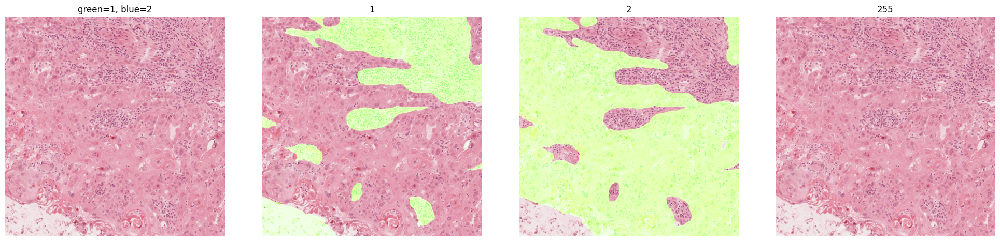

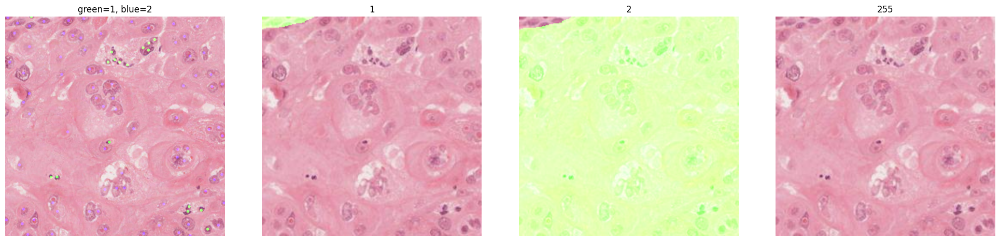


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/389.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/389.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/389.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/389.png


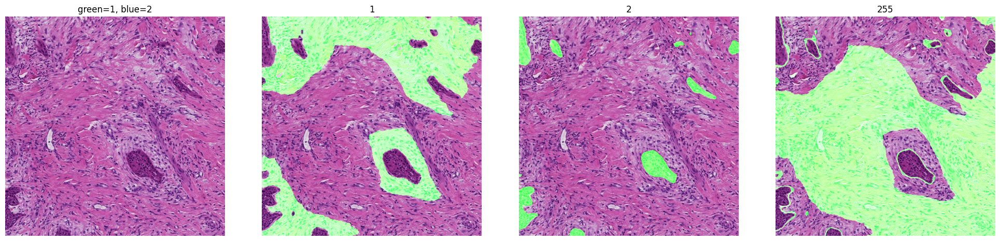

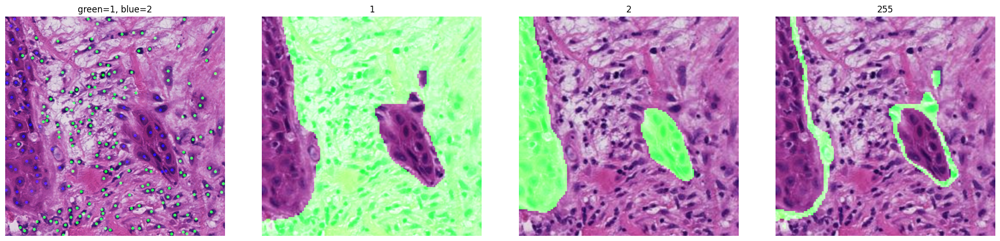


x_start =  0 256
y_start =  512 768
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/391.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/391.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/391.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/391.png


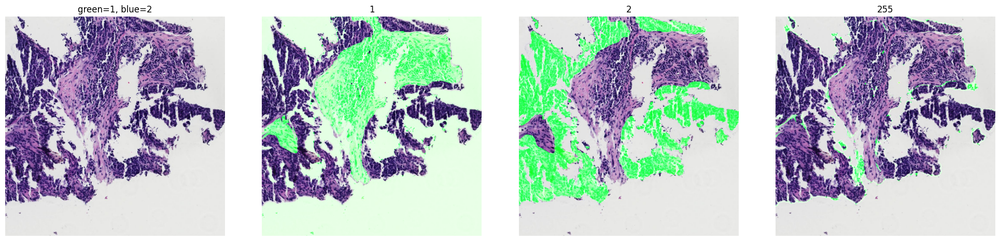

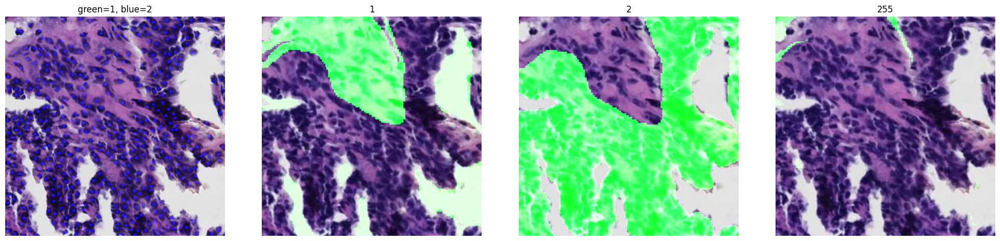


/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/396.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/396.png
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/396.jpg
/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/396.png


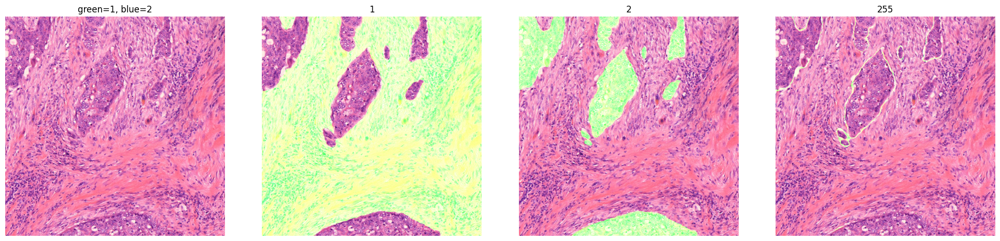

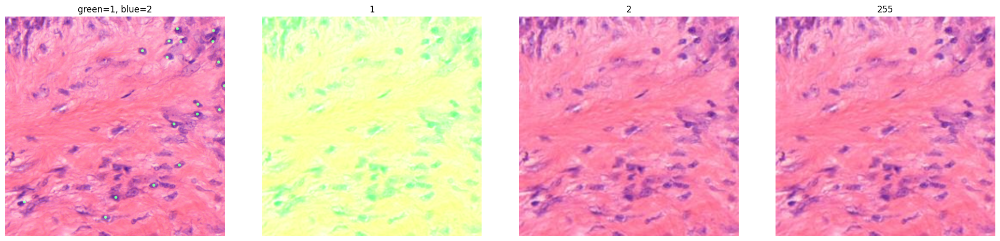

In [19]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

ocelot2023_cell      = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/cell/*.jpg'))[-5:]
ocelot2023_cell_gt   = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/cell_seg/*.png'))[-5:]
ocelot2023_tissue    = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/valid/tissue/*.jpg'))[-5:]
ocelot2023_tissue_gt = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/valid/tissue/*.png'))[-5:]

key_list = [i.split('/')[-1].replace('.jpg', '') for i in ocelot2023_cell][-5:]

for k, c, c_gt, t, t_gt in zip(key_list, ocelot2023_cell, ocelot2023_cell_gt, ocelot2023_tissue, ocelot2023_tissue_gt):
    y_start, y_end, x_start, x_end = convert_coordinate(json_data['sample_pairs'][k])

    if x_start != y_start:
        print("x_start = ", x_start, x_end)
        print("y_start = ", y_start, y_end)
    
    print(c)
    print(c_gt)
    print(t)
    print(t_gt)

    cell = cv2.imread(c, cv2.IMREAD_COLOR)
    cell = cv2.cvtColor(cell, cv2.COLOR_BGR2RGB)    

    cell_gt = cv2.imread(c_gt, cv2.IMREAD_GRAYSCALE)

    tissue = cv2.imread(t, cv2.IMREAD_COLOR)
    tissue = cv2.cvtColor(tissue, cv2.COLOR_BGR2RGB)    

    tissue_gt = cv2.imread(t_gt, cv2.IMREAD_GRAYSCALE)

    plt.figure(figsize=(20, 5))

    plt.subplot(1,4,1)   
    plt.tight_layout()
    plt.axis('off')
    plt.title('green=1, blue=2')
    plt.imshow(tissue)

    plt.subplot(1,4,2)   
    tissue[..., 1][tissue_gt==1] = 255
    plt.tight_layout()
    plt.axis('off')    
    plt.title('1')
    plt.imshow(tissue)

    plt.subplot(1,4,3)
    tissue = cv2.imread(t, cv2.IMREAD_COLOR)
    tissue = cv2.cvtColor(tissue, cv2.COLOR_BGR2RGB)        
    tissue[..., 1][tissue_gt==2] = 255
    plt.tight_layout()
    plt.axis('off')    
    plt.title('2')
    plt.imshow(tissue)

    plt.subplot(1,4,4)
    tissue = cv2.imread(t, cv2.IMREAD_COLOR)
    tissue = cv2.cvtColor(tissue, cv2.COLOR_BGR2RGB)        
    tissue[..., 1][tissue_gt==255] = 255
    plt.tight_layout()
    plt.axis('off')    
    plt.title('255')
    plt.imshow(tissue)

    plt.show()



    plt.figure(figsize=(20, 5))

    plt.subplot(1,4,1)   
    tissue = cv2.imread(t, cv2.IMREAD_COLOR)
    tissue = cv2.cvtColor(tissue, cv2.COLOR_BGR2RGB)        
    cell[..., 1][cell_gt==1] = 255
    cell[..., 2][cell_gt==2] = 255
    plt.tight_layout()
    plt.axis('off')
    plt.title('green=1, blue=2')
    plt.imshow(cell)

    plt.subplot(1,4,2)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue,    (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)
    cropped_tissue[..., 1][cropped_tissue_gt==1] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('1')
    plt.imshow(cropped_tissue)

    plt.subplot(1,4,3)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue, (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)
    cropped_tissue[..., 1][cropped_tissue_gt==2] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('2')
    plt.imshow(cropped_tissue)


    plt.subplot(1,4,4)
    cropped_tissue    = tissue[y_start:y_end, x_start:x_end, :]
    cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    cropped_tissue    = cv2.resize(cropped_tissue, (1024, 1024), interpolation=cv2.INTER_LINEAR)
    cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)
    cropped_tissue[..., 1][cropped_tissue_gt==255] = 255 # CA
    plt.tight_layout()
    plt.axis('off')    
    plt.title('255')
    plt.imshow(cropped_tissue)

    plt.show()
    

    print("=================================================")
    print("")


    # cropped_tissue_gt = tissue_gt[y_start:y_end, x_start:x_end]
    # cropped_tissue_gt = cv2.resize(cropped_tissue_gt, (1024, 1024), interpolation=cv2.INTER_NEAREST)    
    # cv2.imwrite(t_gt.replace('/tissue', '/tissue_cropped'), cropped_tissue_gt)

    


# random sample train/valid split

In [ ]:
ocelot2023_cell      = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/cell/*.jpg'))
ocelot2023_cell_gt   = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/train/cell_seg/*.png'))
ocelot2023_tissue    = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/train/tissue/*.jpg'))
ocelot2023_tissue_gt = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/annotations/train/tissue/*.png'))


In [72]:
# 001 ~ 400 중에 랜덤하게 320개 샘플링하기
import random
random.seed(42)
random_list = random.sample(range(1, 401), 80)

In [73]:
# random_list안에 요소들 string으로 변경하여 3글자로 채우기
random_list = [str(i).zfill(3) for i in random_list]

In [75]:
# 파일 옮기기
import shutil
root = '/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/'

for i in random_list:
    shutil.move(root + 'annotations/train/cell_csv/' + i + '.csv', root + 'annotations/valid/cell_csv/' + i + '.csv')
    shutil.move(root + 'annotations/train/cell_gaussian/' + i + '.npy', root + 'annotations/valid/cell_gaussian/' + i + '.npy')
    shutil.move(root + 'annotations/train/cell_seg/' + i + '.png', root + 'annotations/valid/cell_seg/' + i + '.png')
    shutil.move(root + 'annotations/train/tissue/' + i + '.png', root + 'annotations/valid/tissue/' + i + '.png')
    shutil.move(root + 'annotations/train/tissue_cropped/' + i + '.png', root + 'annotations/valid/tissue_cropped/' + i + '.png')

    shutil.move(root + 'images/train/cell/' + i + '.jpg', root + 'images/valid/cell/' + i + '.jpg')
    shutil.move(root + 'images/train/cell_overlap/' + i + '.png', root + 'images/valid/cell_overlap/' + i + '.png')
    shutil.move(root + 'images/train/tissue/' + i + '.jpg', root + 'images/valid/tissue/' + i + '.jpg')



# RandStainNA preprocessing

In [21]:
import os
import cv2
import numpy as np
import time
import argparse
import yaml
import json
import random
import copy
from skimage import color
from fitter import Fitter



def getavgstd(image):
    avg = []
    std = []
    image_avg_l = np.mean(image[:, :, 0])
    image_std_l = np.std(image[:, :, 0])
    image_avg_a = np.mean(image[:, :, 1])
    image_std_a = np.std(image[:, :, 1])
    image_avg_b = np.mean(image[:, :, 2])
    image_std_b = np.std(image[:, :, 2])
    avg.append(image_avg_l)
    avg.append(image_avg_a)
    avg.append(image_avg_b)
    std.append(image_std_l)
    std.append(image_std_a)
    std.append(image_std_b)
    return (avg, std)


In [25]:
labL_avg_List = []
labA_avg_List = []
labB_avg_List = []
labL_std_List = []
labA_std_List = []
labB_std_List = []

all_image_list = list_sort_nicely(glob.glob('/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/dataset/ocelot2023_v0.1.2/images/*/cell/*.jpg'))

for image in all_image_list:

    img = cv2.imread(image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

    # if args.color_space == "LAB":
    #     img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    # elif args.color_space == "HED":
    #     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    #     img = color.rgb2hed(img)
    # elif args.color_space == "HSV":
    #     img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    # else:
    #     print("wrong color space: {}!!".format(args.color_space))

    img_avg, img_std = getavgstd(img)
    
    labL_avg_List.append(img_avg[0])
    labA_avg_List.append(img_avg[1])
    labB_avg_List.append(img_avg[2])
    labL_std_List.append(img_std[0])
    labA_std_List.append(img_std[1])
    labB_std_List.append(img_std[2])

l_avg_mean = np.mean(labL_avg_List).item()
l_avg_std  = np.std(labL_avg_List).item()
l_std_mean = np.mean(labL_std_List).item()
l_std_std  = np.std(labL_std_List).item()

a_avg_mean = np.mean(labA_avg_List).item()
a_avg_std  = np.std(labA_avg_List).item()
a_std_mean = np.mean(labA_std_List).item()
a_std_std  = np.std(labA_std_List).item()

b_avg_mean = np.mean(labB_avg_List).item()
b_avg_std  = np.std(labB_avg_List).item()
b_std_mean = np.mean(labB_std_List).item()
b_std_std  = np.std(labB_std_List).item()

std_avg_list = [
    labL_avg_List,
    labL_std_List,
    labA_avg_List,
    labA_std_List,
    labB_avg_List,
    labB_std_List,
]


color_space = "LAB"
distribution = []
for std_avg in std_avg_list:
    f = Fitter(std_avg, distributions=["norm", "laplace"])
    f.fit()
    distribution.append(list(f.get_best(method="sumsquare_error").keys())[0])

yaml_dict_lab = {

    "{}".format(color_space[0]): {  # lab-L/hed-H
        "avg": {
            "mean": round(l_avg_mean, 3),
            "std": round(l_avg_std, 3),
            "distribution": distribution[0],
        },
        "std": {
            "mean": round(l_std_mean, 3),
            "std": round(l_std_std, 3),
            "distribution": distribution[1],
        },
    },
    "{}".format(color_space[1]): {  # lab-A/hed-E
        "avg": {
            "mean": round(a_avg_mean, 3),
            "std": round(a_avg_std, 3),
            "distribution": distribution[2],
        },
        "std": {
            "mean": round(a_std_mean, 3),
            "std": round(a_std_std, 3),
            "distribution": distribution[3],
        },
    },
    "{}".format(color_space[2]): {  # lab-B/hed-D
        "avg": {
            "mean": round(b_avg_mean, 3),
            "std": round(b_avg_std, 3),
            "distribution": distribution[4],
        },
        "std": {
            "mean": round(b_std_mean, 3),
            "std": round(b_std_std, 3),
            "distribution": distribution[5],
        },
    },
}


Fitting 2 distributions: 100%|██████████| 2/2 [00:00<00:00, 151.69it/s]


In [26]:
yaml_dict_lab

{'L': {'avg': {'mean': 168.156, 'std': 30.095, 'distribution': 'norm'},
  'std': {'mean': 42.425, 'std': 11.151, 'distribution': 'laplace'}},
 'A': {'avg': {'mean': 151.214, 'std': 10.104, 'distribution': 'norm'},
  'std': {'mean': 9.85, 'std': 2.922, 'distribution': 'norm'}},
 'B': {'avg': {'mean': 119.39, 'std': 5.821, 'distribution': 'norm'},
  'std': {'mean': 6.813, 'std': 2.149, 'distribution': 'laplace'}}}

In [1]:
cd /workspace/sunggu/0.Challenge/MICCAI2023_OCELOT/

/workspace/sunggu/0.Challenge/MICCAI2023_OCELOT


In [2]:
from dataloaders import get_dataloader

train_loader = get_dataloader(name='ocelot_cell_monai_segmentation', mode='train', batch_size=4, num_workers=4)   
valid_loader = get_dataloader(name='ocelot_cell_monai_segmentation', mode='valid', batch_size=4, num_workers=4)   

Train [Total] number =  318
Valid [Total] number =  79


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


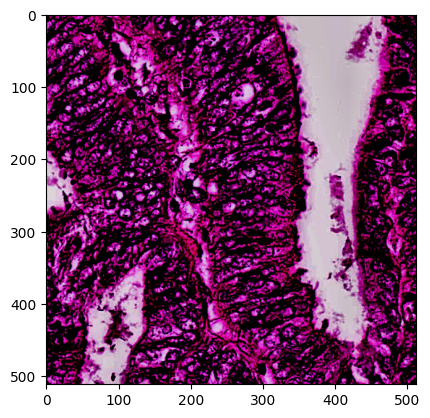

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.8902) tensor(-1.)


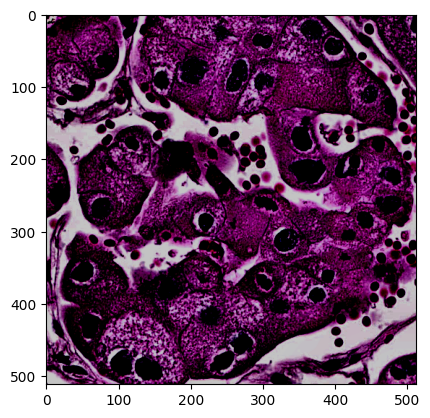

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.7647) tensor(-1.)


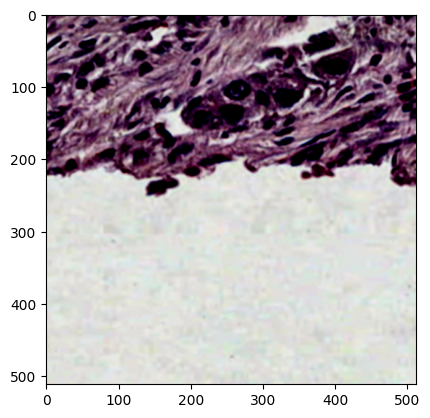

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.9608) tensor(-0.8510)


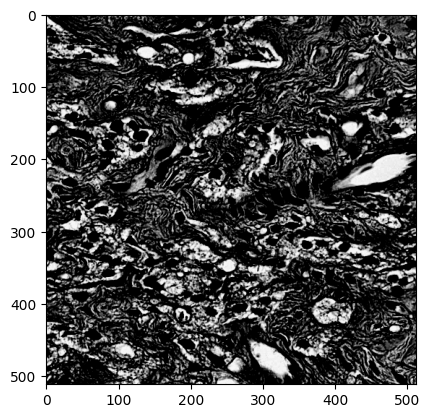

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(0.9686) tensor(-0.9686)


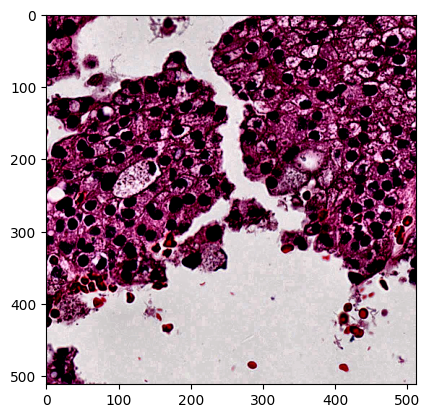

tensor(1.) tensor(-1.)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


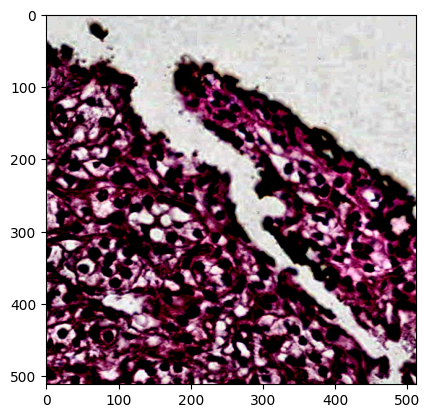

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.) tensor(-1.)


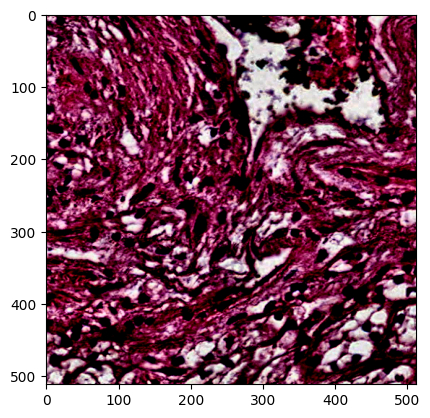

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1.) tensor(-1.)


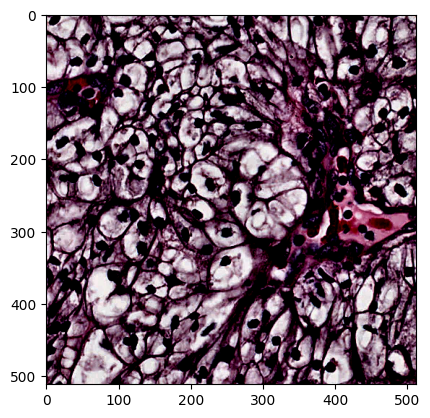

tensor(1.) tensor(-1.)


In [6]:
import matplotlib.pyplot as plt

a = next(iter(train_loader))
b = next(iter(valid_loader))

for i in range(4):
    plt.imshow(a[0][i].permute(1, 2, 0))
    plt.show()
    print(a[0][i].permute(1, 2, 0).max(), a[0][i].permute(1, 2, 0).min())


for i in range(4):
    plt.imshow(b[0][i].permute(1, 2, 0))
    plt.show()
    print(b[0][i].permute(1, 2, 0).max(), b[0][i].permute(1, 2, 0).min())

